## Imports

In [1]:
## Imports
import os
import warnings
warnings.filterwarnings("ignore")
from IPython.display import display
import math
import joblib
import random
import copy

from matplotlib import pyplot as plt
import sklearn
from sklearn import tree
from sklearn.tree import DecisionTreeRegressor 
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import numpy as np
import pandas as pd
import h5py
import altair as alt

## Set options
# display all columns in pandas dataframe
pd.set_option('display.max_columns',None)
# allow unlimited number of rows in altair datasets
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

## Read and Load Data

In [2]:
## Read in 2D and 3D onehot encoded representations of the data 
with h5py.File('floris_data.h5', 'r') as hf:
    full_2d_arr = hf['/One-hot Encoded/2D Representation/Full 2D array'][()]
    # plant_2d_arr = hf['/One-hot Encoded/3D Representation/Plant Level 2D array'][()]
    # turb_3d_arr = hf['/One-hot Encoded/3D Representation/Turbine Level 3D array'][()]

In [3]:
## Generate column headers list and data type dictionary for instantiating pandas dataframe
# Determine max number of turbines present in simulation data
max_num_turbs = int(max(full_2d_arr[:,3]))

# Generate turbine specific feature column headers ranging between 000-max_num_turbs, = one-hot encoded values for each turbine 
t_dummy_vars = ['t_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
t_X_vars = ['t_X_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
t_Y_vars = ['t_Y_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
t_yaw_vars = ['t_yaw_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
t_ws_vars = ['t_ws_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
t_power_vars = ['t_power_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
# Define plant level variables
plant_vars   = ['layout',           # index for LayoutXXX
                'scenario',         # index for ScenarioXXX
                'opt_yaw',          # binary if sample is yaw optimized
                'num_turbines',     # number of turbines in the layout
                'hub_h',            
                'rotor_d',
                'wind_dir',         # wind direction
                'wind_speed',       
                'turbulence',]
# create list to hold all column names
column_names = []
column_names.extend(plant_vars)
column_names.extend(t_dummy_vars)
column_names.extend(t_X_vars)
column_names.extend(t_Y_vars)
column_names.extend(t_yaw_vars)
column_names.extend(t_ws_vars)
column_names.extend(t_power_vars)

# Define datatypes for each column
plant_vars_type = ['int32',
                   'int32',
                   'int8',
                   'int32',
                   'float32',
                   'float32',
                   'float32',
                   'float32',
                   'float32']
turb_vars_type = ['float32' for i in range(max_num_turbs)]

data_type_dict = dict(zip(plant_vars, plant_vars_type))
data_type_dict.update(dict(zip(t_dummy_vars,['int8' for i in range(max_num_turbs)])))
data_type_dict.update(dict(zip(t_X_vars,turb_vars_type)))
data_type_dict.update(dict(zip(t_Y_vars,turb_vars_type)))
data_type_dict.update(dict(zip(t_yaw_vars,turb_vars_type)))
data_type_dict.update(dict(zip(t_ws_vars,turb_vars_type)))
data_type_dict.update(dict(zip(t_power_vars,turb_vars_type)))

In [4]:
## Convert the Full 2D array to a pandas dataframe with column headers for exploratory data analysis
df = pd.DataFrame(data=full_2d_arr, columns=column_names)
df = df.astype(data_type_dict)
print(df.shape)
df.head()

(252500, 1203)


,layout,scenario,opt_yaw,num_turbines,hub_h,rotor_d,wind_dir,wind_speed,turbulence,t_000,t_001,t_002,t_003,t_004,t_005,t_006,t_007,t_008,t_009,t_010,t_011,t_012,t_013,t_014,t_015,t_016,t_017,t_018,t_019,t_020,t_021,t_022,t_023,t_024,t_025,t_026,t_027,t_028,t_029,t_030,t_031,t_032,t_033,t_034,t_035,t_036,t_037,t_038,t_039,t_040,t_041,t_042,t_043,t_044,t_045,t_046,t_047,t_048,t_049,t_050,t_051,t_052,t_053,t_054,t_055,t_056,t_057,t_058,t_059,t_060,t_061,t_062,t_063,t_064,t_065,t_066,t_067,t_068,t_069,t_070,t_071,t_072,t_073,t_074,t_075,t_076,t_077,t_078,t_079,t_080,t_081,t_082,t_083,t_084,t_085,t_086,t_087,t_088,t_089,t_090,t_091,t_092,t_093,t_094,t_095,t_096,t_097,t_098,t_099,t_100,t_101,t_102,t_103,t_104,t_105,t_106,t_107,t_108,t_109,t_110,t_111,t_112,t_113,t_114,t_115,t_116,t_117,t_118,t_119,t_120,t_121,t_122,t_123,t_124,t_125,t_126,t_127,t_128,t_129,t_130,t_131,t_132,t_133,t_134,t_135,t_136,t_137,t_138,t_139,t_140,t_141,t_142,t_143,t_144,t_145,t_146,t_147,t_148,t_149,t_150,t_151,t_152,t_153,t_154,t_155,t_156,t_157,t_158,t_159,t_160,t_161,t_162,t_163,t_164,t_165,t_166,t_167,t_168,t_169,t_170,t_171,t_172,t_173,t_174,t_175,t_176,t_177,t_178,t_179,t_180,t_181,t_182,t_183,t_184,t_185,t_186,t_187,t_188,t_189,t_190,t_191,t_192,t_193,t_194,t_195,t_196,t_197,t_198,t_X_000,t_X_001,t_X_002,t_X_003,t_X_004,t_X_005,t_X_006,t_X_007,t_X_008,t_X_009,t_X_010,t_X_011,t_X_012,t_X_013,t_X_014,t_X_015,t_X_016,t_X_017,t_X_018,t_X_019,t_X_020,t_X_021,t_X_022,t_X_023,t_X_024,t_X_025,t_X_026,t_X_027,t_X_028,t_X_029,t_X_030,t_X_031,t_X_032,t_X_033,t_X_034,t_X_035,t_X_036,t_X_037,t_X_038,t_X_039,t_X_040,t_X_041,t_X_042,t_X_043,t_X_044,t_X_045,t_X_046,t_X_047,t_X_048,t_X_049,t_X_050,t_X_051,t_X_052,t_X_053,t_X_054,t_X_055,t_X_056,t_X_057,t_X_058,t_X_059,t_X_060,t_X_061,t_X_062,t_X_063,t_X_064,t_X_065,t_X_066,t_X_067,t_X_068,t_X_069,t_X_070,t_X_071,t_X_072,t_X_073,t_X_074,t_X_075,t_X_076,t_X_077,t_X_078,t_X_079,t_X_080,t_X_081,t_X_082,t_X_083,t_X_084,t_X_085,t_X_086,t_X_087,t_X_088,t_X_089,t_X_090,t_X_091,t_X_092,t_X_093,t_X_094,t_X_095,t_X_096,t_X_097,t_X_098,t_X_099,t_X_100,t_X_101,t_X_102,t_X_103,t_X_104,t_X_105,t_X_106,t_X_107,t_X_108,t_X_109,t_X_110,t_X_111,t_X_112,t_X_113,t_X_114,t_X_115,t_X_116,t_X_117,t_X_118,t_X_119,t_X_120,t_X_121,t_X_122,t_X_123,t_X_124,t_X_125,t_X_126,t_X_127,t_X_128,t_X_129,t_X_130,t_X_131,t_X_132,t_X_133,t_X_134,t_X_135,t_X_136,t_X_137,t_X_138,t_X_139,t_X_140,t_X_141,t_X_142,t_X_143,t_X_144,t_X_145,t_X_146,t_X_147,t_X_148,t_X_149,t_X_150,t_X_151,t_X_152,t_X_153,t_X_154,t_X_155,t_X_156,t_X_157,t_X_158,t_X_159,t_X_160,t_X_161,t_X_162,t_X_163,t_X_164,t_X_165,t_X_166,t_X_167,t_X_168,t_X_169,t_X_170,t_X_171,t_X_172,t_X_173,t_X_174,t_X_175,t_X_176,t_X_177,t_X_178,t_X_179,t_X_180,t_X_181,t_X_182,t_X_183,t_X_184,t_X_185,t_X_186,t_X_187,t_X_188,t_X_189,t_X_190,t_X_191,t_X_192,t_X_193,t_X_194,t_X_195,t_X_196,t_X_197,t_X_198,t_Y_000,t_Y_001,t_Y_002,t_Y_003,t_Y_004,t_Y_005,t_Y_006,t_Y_007,t_Y_008,t_Y_009,t_Y_010,t_Y_011,t_Y_012,t_Y_013,t_Y_014,t_Y_015,t_Y_016,t_Y_017,t_Y_018,t_Y_019,t_Y_020,t_Y_021,t_Y_022,t_Y_023,t_Y_024,t_Y_025,t_Y_026,t_Y_027,t_Y_028,t_Y_029,t_Y_030,t_Y_031,t_Y_032,t_Y_033,t_Y_034,t_Y_035,t_Y_036,t_Y_037,t_Y_038,t_Y_039,t_Y_040,t_Y_041,t_Y_042,t_Y_043,t_Y_044,t_Y_045,t_Y_046,t_Y_047,t_Y_048,t_Y_049,t_Y_050,t_Y_051,t_Y_052,t_Y_053,t_Y_054,t_Y_055,t_Y_056,t_Y_057,t_Y_058,t_Y_059,t_Y_060,t_Y_061,t_Y_062,t_Y_063,t_Y_064,t_Y_065,t_Y_066,t_Y_067,t_Y_068,t_Y_069,t_Y_070,t_Y_071,t_Y_072,t_Y_073,t_Y_074,t_Y_075,t_Y_076,t_Y_077,t_Y_078,t_Y_079,t_Y_080,t_Y_081,t_Y_082,t_Y_083,t_Y_084,t_Y_085,t_Y_086,t_Y_087,t_Y_088,t_Y_089,t_Y_090,t_Y_091,t_Y_092,t_Y_093,t_Y_094,t_Y_095,t_Y_096,t_Y_097,t_Y_098,t_Y_099,t_Y_100,t_Y_101,t_Y_102,t_Y_103,t_Y_104,t_Y_105,t_Y_106,t_Y_107,t_Y_108,t_Y_109,t_Y_110,t_Y_111,t_Y_112,t_Y_113,t_Y_114,t_Y_115,t_Y_116,t_Y_117,t_Y_118,t_Y_119,t_Y_120,t_Y_121,t_Y_122,t_Y_123,t_Y_124,t_Y_125,t_Y_126,t_Y_127,t_Y_128,t_Y_129,t_Y_130,t_Y_131,t_Y_132,t_Y_133,t_Y_134,t_Y_135,t_Y_136,t_Y_137,t_Y_138,t_Y_139,t_Y_140,t_Y

## EDA

In [5]:
# View key information about the dataframe, shape, columns, datatypes:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 252500 entries, 0 to 252499
Data columns (total 1203 columns):
 #     Column        Dtype  
---    ------        -----  
 0     layout        int32  
 1     scenario      int32  
 2     opt_yaw       int8   
 3     num_turbines  int32  
 4     hub_h         float32
 5     rotor_d       float32
 6     wind_dir      float32
 7     wind_speed    float32
 8     turbulence    float32
 9     t_000         int8   
 10    t_001         int8   
 11    t_002         int8   
 12    t_003         int8   
 13    t_004         int8   
 14    t_005         int8   
 15    t_006         int8   
 16    t_007         int8   
 17    t_008         int8   
 18    t_009         int8   
 19    t_010         int8   
 20    t_011         int8   
 21    t_012         int8   
 22    t_013         int8   
 23    t_014         int8   
 24    t_015         int8   
 25    t_016         int8   
 26    t_017         int8   
 27    t_018         int8   
 28    t_019     

In [6]:
## Identify features and labels
# Ignore t_ws_XXX variables as these are an output created from floris that can be predicted by the model/used to calculate turbine power, not an input for the model
features = list(df.columns[2:-2*max_num_turbs])
print('Features to train on:\n', features)
labels = list(df.columns[-max_num_turbs:])
print('\nLabels to predict:\n', labels)
local_ws =list(df.columns[-2*max_num_turbs:-max_num_turbs])

Features to train on:
 ['opt_yaw', 'num_turbines', 'hub_h', 'rotor_d', 'wind_dir', 'wind_speed', 'turbulence', 't_000', 't_001', 't_002', 't_003', 't_004', 't_005', 't_006', 't_007', 't_008', 't_009', 't_010', 't_011', 't_012', 't_013', 't_014', 't_015', 't_016', 't_017', 't_018', 't_019', 't_020', 't_021', 't_022', 't_023', 't_024', 't_025', 't_026', 't_027', 't_028', 't_029', 't_030', 't_031', 't_032', 't_033', 't_034', 't_035', 't_036', 't_037', 't_038', 't_039', 't_040', 't_041', 't_042', 't_043', 't_044', 't_045', 't_046', 't_047', 't_048', 't_049', 't_050', 't_051', 't_052', 't_053', 't_054', 't_055', 't_056', 't_057', 't_058', 't_059', 't_060', 't_061', 't_062', 't_063', 't_064', 't_065', 't_066', 't_067', 't_068', 't_069', 't_070', 't_071', 't_072', 't_073', 't_074', 't_075', 't_076', 't_077', 't_078', 't_079', 't_080', 't_081', 't_082', 't_083', 't_084', 't_085', 't_086', 't_087', 't_088', 't_089', 't_090', 't_091', 't_092', 't_093', 't_094', 't_095', 't_096', 't_097', 't_098'

In [7]:
# Identify whether the data has any missing values
df.isna().sum().sort_values()

# NOTE: NaNs were intentionally inserted for turbine features where the turbine is not present in the layout. These will be replaced with zero values prior to model training

layout              0
t_X_022             0
t_X_021             0
t_X_020             0
t_X_019             0
                ...  
t_ws_198       251450
t_Y_198        251450
t_yaw_198      251450
t_X_198        251450
t_power_198    251450
Length: 1203, dtype: int64

In [8]:
# General statistics of the data
df[features+labels].describe()

opt_yaw   num_turbines     hub_h   rotor_d       wind_dir  \
count  252500.000000  252500.000000  252500.0  252500.0  252500.000000   
mean        0.009901      98.071683     110.0     130.0     179.969559   
std         0.099010      43.417603       0.0       0.0     103.914276   
min         0.000000      26.000000     110.0     130.0       0.003456   
25%         0.000000      63.000000     110.0     130.0      89.980505   
50%         0.000000      93.000000     110.0     130.0     179.979202   
75%         0.000000     127.000000     110.0     130.0     269.954399   
max         1.000000     199.000000     110.0     130.0     359.998688   

          wind_speed     turbulence     t_000     t_001     t_002     t_003  \
count  252500.000000  252500.000000  252500.0  252500.0  252500.0  252500.0   
mean       12.465832       0.080032       1.0       1.0       1.0       1.0   
std         5.391821       0.016374       0.0       0.0       0.0       0.0   
min         2.000056       0.060000       1.0       1.0       1.0       1.0   
25%         7.946430       0.060000       1.0       1.0       1.0       1.0   
50%        12.313784       0.080000       1.0       1.0       1.0       1.0   
75%        16.782260       0.100000       1.0       1.0       1.0       1.0   
max        24.999769       0.120000       1.0       1.0       1.0       1.0   

          t_004     t_005     t_006     t_007     t_008     t_009     t_010  \
count  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0   
mean        1.0       1.0       1.0       1.0       1.0       1.0       1.0   
std         0.0       0.0       0.0       0.0       0.0       0.0       0.0   
min         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
25%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
50%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
75%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
max         1.0       1.0       1.0       1.0       1.0       1.0       1.0   

          t_011     t_012     t_013     t_014     t_015     t_016     t_017  \
count  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0   
mean        1.0       1.0       1.0       1.0       1.0       1.0       1.0   
std         0.0       0.0       0.0       0.0       0.0       0.0       0.0   
min         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
25%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
50%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
75%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
max         1.0       1.0       1.0       1.0       1.0       1.0       1.0   

          t_018     t_019     t_020     t_021     t_022     t_023     t_024  \
count  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0  252500.0   
mean        1.0       1.0       1.0       1.0       1.0       1.0       1.0   
std         0.0       0.0       0.0       0.0       0.0       0.0       0.0   
min         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
25%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
50%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
75%         1.0       1.0       1.0       1.0       1.0       1.0       1.0   
max         1.0       1.0       1.0       1.0       1.0       1.0       1.0   

          t_025          t_026          t_027          t_028          t_029  \
count  252500.0  252500.000000  252500.000000  252500.000000  252500.000000   
mean        1.0       0.998020       0.994059       0.988119       0.980198   
std         0.0       0.044455       0.076846       0.108352       0.139320   
min         1.0       0.000000       0.000000       0.000000       0.000000   
25%         1.0       1.000000       1.000000       1.000000       1.000000   
50%         1.0       1.

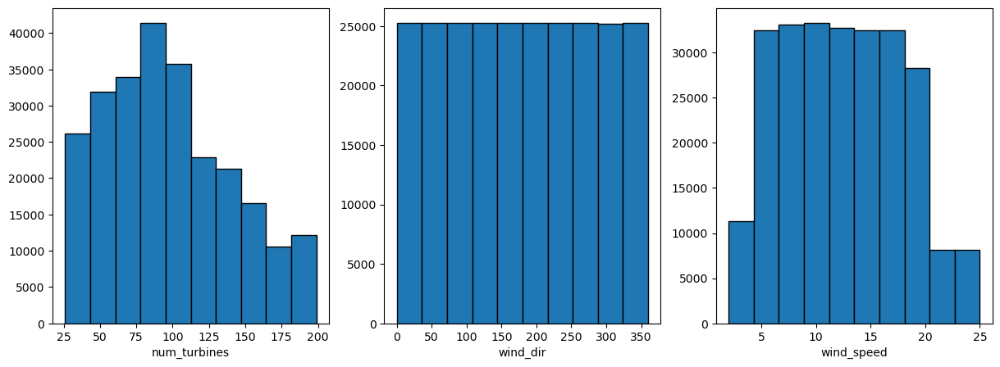

In [10]:
# Create histograms for plant level features to visualized distributions
hist_plant_features = [features[1], features[4], features[5]]
num_cols = 4
num_rows = math.ceil(len(hist_plant_features)/num_cols)

fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(5*num_cols,5*num_rows))
for idx, ax in enumerate(axes.flatten()):
    if idx >= len(hist_plant_features):
        ax.remove()
        break
    ax.hist(df[hist_plant_features[idx]], edgecolor='black')
    # sns.histplot(df[hist_plant_features[idx]], stat="percent", ax=ax)
    ax.set_xlabel(hist_plant_features[idx])


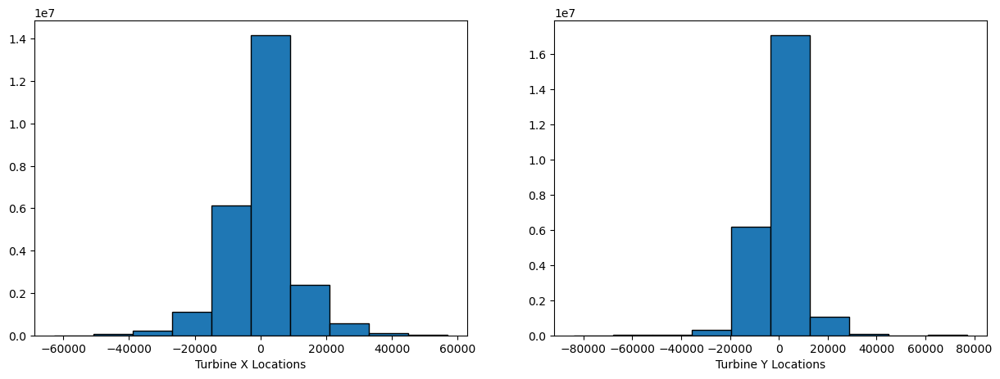

In [11]:
# Create histograms for turbine X and Y locations features to visualized distributions
t_X_idx_start = features.index('t_X_000')
t_X_idx_end = features.index('t_X_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_X_features = features[t_X_idx_start:t_X_idx_end+1]

t_Y_idx_start = features.index('t_Y_000')
t_Y_idx_end = features.index('t_Y_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_Y_features = features[t_Y_idx_start:t_Y_idx_end+1]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
axes[0].hist(df[hist_X_features].unstack().dropna(), edgecolor='black')
axes[0].set_xlabel('Turbine X Locations')
axes[1].hist(df[hist_Y_features].unstack().dropna(), edgecolor='black')
axes[1].set_xlabel('Turbine Y Locations')

plt.show()

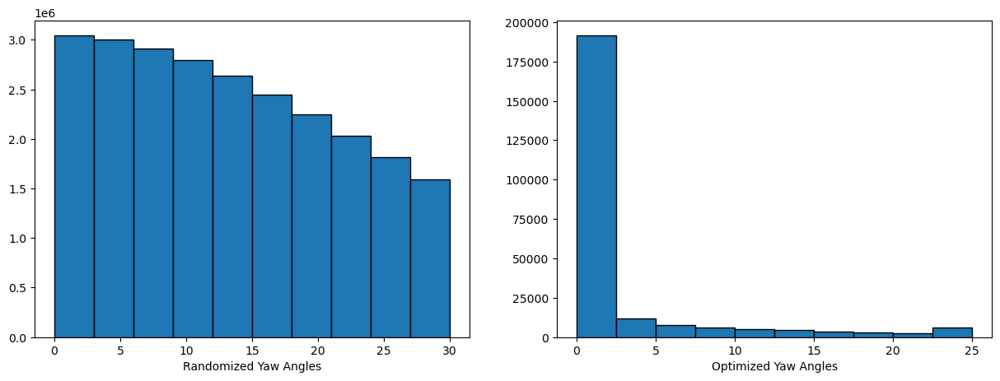

In [12]:
# Create histograms for turbine yaw angle features to visualized distributions
t_yaw_idx_start = features.index('t_yaw_000')
t_yaw_idx_end = features.index('t_yaw_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_yaw_features = features[t_yaw_idx_start:t_yaw_idx_end+1]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
axes[0].hist(df[df['opt_yaw'] == 0][hist_yaw_features].unstack().dropna(), edgecolor='black')
axes[0].set_xlabel('Randomized Yaw Angles')
axes[1].hist(df[df['opt_yaw'] == 1][hist_yaw_features].unstack().dropna(), edgecolor='black')
axes[1].set_xlabel('Optimized Yaw Angles')

plt.show()


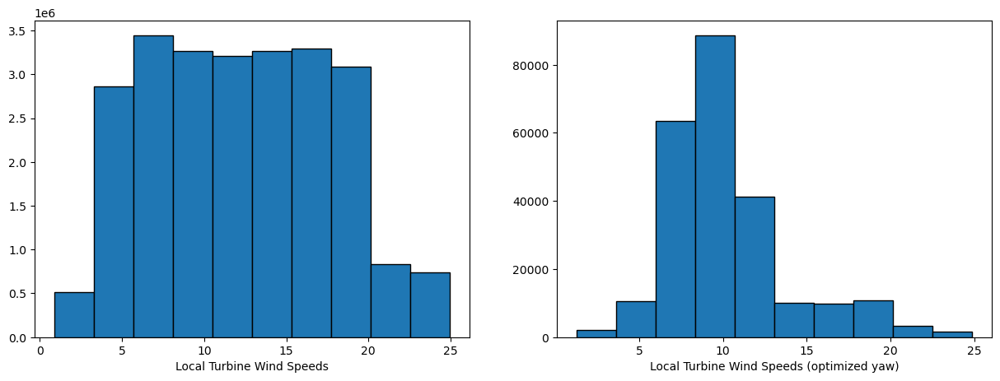

In [13]:
# Create histograms for local turbine wind speeds to visualized distributions
t_ws_idx_start = local_ws.index('t_ws_000')
t_ws_idx_end = local_ws.index('t_ws_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_ws_features = local_ws[t_ws_idx_start:t_ws_idx_end+1]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
axes[0].hist(df[df['opt_yaw'] == 0][hist_ws_features].unstack().dropna(), edgecolor='black')
axes[0].set_xlabel('Local Turbine Wind Speeds')
axes[1].hist(df[df['opt_yaw'] == 1][hist_ws_features].unstack().dropna(), edgecolor='black')
axes[1].set_xlabel('Local Turbine Wind Speeds (optimized yaw)')
plt.show()

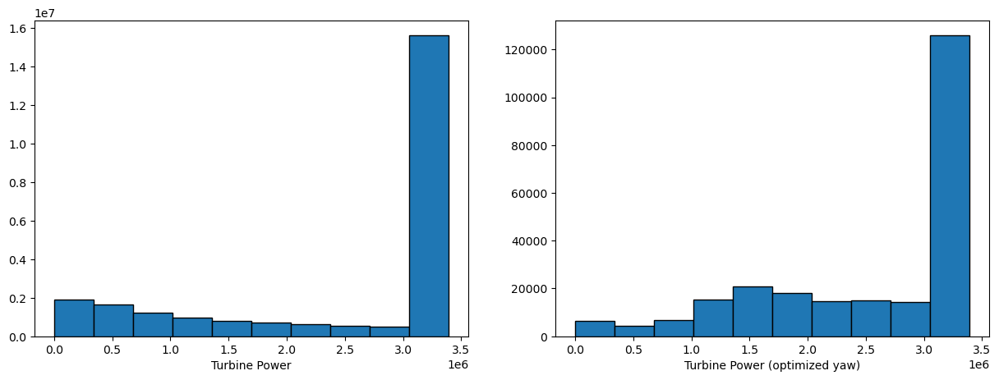

In [14]:
# Create histograms for turbine power outputs features to visualized distributions
t_power_idx_start = labels.index('t_power_000')
t_power_idx_end = labels.index('t_power_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_power_features = labels[t_power_idx_start:t_power_idx_end+1]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
axes[0].hist(df[df['opt_yaw'] == 0][hist_power_features].unstack().dropna(), edgecolor='black')
axes[0].set_xlabel('Turbine Power')
axes[1].hist(df[df['opt_yaw'] == 1][hist_power_features].unstack().dropna(), edgecolor='black')
axes[1].set_xlabel('Turbine Power (optimized yaw)')
plt.show()

In [15]:
# Create scatter plot for visualizing Plant Power vs plant wind speed
df_alt = df[['opt_yaw','wind_speed']]
df_alt['norm_plant_power'] =  df[hist_power_features].sum(axis=1).div(df['num_turbines']*3.4e6)
df_alt['opt_yaw'] = df_alt['opt_yaw'].astype(bool)

df_alt.head()

non_opt = alt.Chart(df_alt[df_alt['opt_yaw']==0]).mark_circle().encode(
    x = alt.X('wind_speed:Q', title='Plant Level Wind Speed'),
    y = alt.Y('norm_plant_power:Q', title='Normalized Plant Power'),
    color = alt.Color('opt_yaw:N', title='Optimized Yaw Angles')
)

opt = alt.Chart(df_alt[df_alt['opt_yaw']==1]).mark_circle(opacity=0.3).encode(
    x = alt.X('wind_speed:Q', title='Plant Level Wind Speed'),
    y = alt.Y('norm_plant_power:Q', title='Normalized Plant Power'),
    color = alt.Color('opt_yaw:N', title='Optimized Yaw Angles')
)

non_opt + opt

alt.LayerChart(...)

In [157]:
# Create scatterplot to visualize plant layout and turbine power
t_X_idx_start = features.index('t_X_000')
t_X_idx_end = features.index('t_X_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_X_features = features[t_X_idx_start:t_X_idx_end+1]

t_Y_idx_start = features.index('t_Y_000')
t_Y_idx_end = features.index('t_Y_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_Y_features = features[t_Y_idx_start:t_Y_idx_end+1]

t_power_idx_start = labels.index('t_power_000')
t_power_idx_end = labels.index('t_power_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_power_features = labels[t_power_idx_start:t_power_idx_end+1]

ridx = random.randint(0,len(df)-1)

x_locs = df[hist_X_features].iloc[ridx].values.T
y_locs = df[hist_Y_features].iloc[ridx].values.T
t_powers = df[hist_power_features].iloc[ridx].values.T

df_alt2 = pd.DataFrame([x_locs,y_locs,t_powers]).T
df_alt2.columns = ['x_loc','y_loc','t_powers']
df_alt2.dropna(inplace=True)
df_alt2['t_powers'] = df_alt2['t_powers'].div(1e6)

alt.Chart(df_alt2).mark_circle().encode(
    x = alt.X('x_loc:Q', title='X Location'),
    y = alt.Y('y_loc:Q', title='Y Location'),
    color = alt.Color('t_powers:Q', scale=alt.Scale(scheme='viridis'), legend=alt.Legend(format=',.3f'), title='Turbine Power (MW)'),
)


alt.Chart(...)

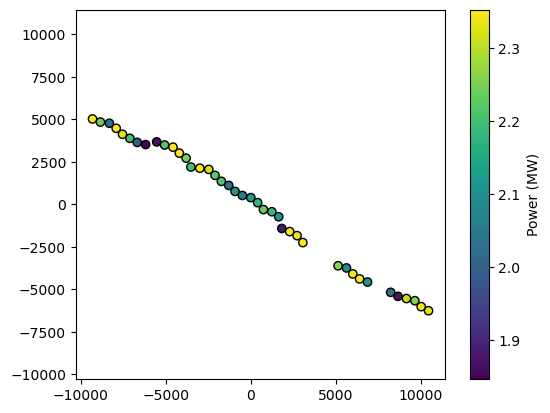

In [178]:
# Create scatterplot to visualize plant layout and turbine power
t_X_idx_start = features.index('t_X_000')
t_X_idx_end = features.index('t_X_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_X_features = features[t_X_idx_start:t_X_idx_end+1]

t_Y_idx_start = features.index('t_Y_000')
t_Y_idx_end = features.index('t_Y_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_Y_features = features[t_Y_idx_start:t_Y_idx_end+1]

t_power_idx_start = labels.index('t_power_000')
t_power_idx_end = labels.index('t_power_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
hist_power_features = labels[t_power_idx_start:t_power_idx_end+1]

ridx = random.randint(0,len(df)-1)

x_locs = df[hist_X_features].iloc[ridx].values.T
y_locs = df[hist_Y_features].iloc[ridx].values.T
t_powers = df[hist_power_features].iloc[ridx].values.T

df_alt2 = pd.DataFrame([x_locs,y_locs,t_powers]).T
df_alt2.columns = ['x_loc','y_loc','t_powers']
df_alt2.dropna(inplace=True)
df_alt2['t_powers'] = df_alt2['t_powers'].div(1e6)

plt.figure()
plt.scatter(x=df_alt2['x_loc'], y=df_alt2['y_loc'], c=df_alt2['t_powers'], edgecolor='k')
xlim = plt.gca().get_xlim()
ylim = plt.gca().get_ylim()
plt.xlim(np.minimum(xlim[0], ylim[0]), np.maximum(xlim[1], ylim[1]))
plt.ylim(np.minimum(xlim[0], ylim[0]), np.maximum(xlim[1], ylim[1]))
plt.gca().set_aspect(1.)
cbar = plt.colorbar()
cbar.set_label('Power (MW)')

plt.show()



## Model Pipeline

### Define Helper Functions

In [16]:
def load_full_2d_to_df():
    ## Generate column headers list and data type dictionary for instantiating pandas dataframe
    # Generate turbine specific feature column headers ranging between 000-max_num_turbs, = one-hot encoded values for each turbine 
    t_dummy_vars = ['t_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    t_X_vars = ['t_X_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    t_Y_vars = ['t_Y_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    t_yaw_vars = ['t_yaw_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    t_ws_vars = ['t_ws_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    t_power_vars = ['t_power_{x}'.format(x=str(y).zfill(3)) for y in range(max_num_turbs)]
    # Define plant level variables
    plant_vars   = ['layout',           # index for LayoutXXX
                    'scenario',         # index for ScenarioXXX
                    'opt_yaw',          # binary if sample is yaw optimized
                    'num_turbines',     # number of turbines in the layout
                    'hub_h',            
                    'rotor_d',
                    'wind_dir',         # wind direction
                    'wind_speed',       
                    'turbulence',]
    # create list to hold all column names
    column_names = []
    column_names.extend(plant_vars)
    column_names.extend(t_dummy_vars)
    column_names.extend(t_X_vars)
    column_names.extend(t_Y_vars)
    column_names.extend(t_yaw_vars)
    column_names.extend(t_ws_vars)
    column_names.extend(t_power_vars)

    # Define datatypes for each column
    plant_vars_type = ['int32',
                    'int32',
                    'int8',
                    'int32',
                    'float32',
                    'float32',
                    'float32',
                    'float32',
                    'float32']
    turb_vars_type = ['float32' for i in range(max_num_turbs)]

    data_type_dict = dict(zip(plant_vars, plant_vars_type))
    data_type_dict.update(dict(zip(t_dummy_vars,['int8' for i in range(max_num_turbs)])))
    data_type_dict.update(dict(zip(t_X_vars,turb_vars_type)))
    data_type_dict.update(dict(zip(t_Y_vars,turb_vars_type)))
    data_type_dict.update(dict(zip(t_yaw_vars,turb_vars_type)))
    data_type_dict.update(dict(zip(t_ws_vars,turb_vars_type)))
    data_type_dict.update(dict(zip(t_power_vars,turb_vars_type)))

    ## Convert the Full 2D array to a pandas dataframe with column headers for exploratory data analysis
    df = pd.DataFrame(data=full_2d_arr, columns=column_names)
    df = df.astype(data_type_dict)
    
    return df

In [17]:
def split_data(X, y, split=(0.6, 0.2, 0.2), random_seed=888):
    """
    Splits X/y into training, validation, and testing sets based on the
    specified split.

    Parameters
    ----------
    X : np.ndarray
        Collection of sample features to train on
    y : np.ndarray
        Collection of sample labels to be predicted (turbine power)
    split : tuple
        The percentage allocation of training, validation, and test datasets
        Default: (0.6, 0.2, 0.2)
    random_seed : int
        The seed for the random number generator
        Default: 888

    Returns
    -------
    X_train, X_val, X_test, y_train, y_val, y_test : np.ndarrays
        The X and y training, validation, and test datasets 
    """
    # Input checking
    if len(X) != len(y):
        raise ValueError(f"X and y lengths don't match ({len(X)} != {len(y)})")
    if len(split) != 3:
        raise ValueError("Invalid split, expected 3 percentages (training, validation, test)")
    if sum(split) != 1:
        raise ValueError(f"Invalid split {split}, percentages must sum to 1.0")
    if not isinstance(X, np.ndarray) or not isinstance(y, np.ndarray):
        raise TypeError("X and y must be numpy arrays")

    # Initial split for testing data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=split[2], random_state=random_seed, stratify=X[:,0]         # stratify based on # of optimized yaw simulations in each set (first column in X)
    )

    # Further split for validation data
    val_size = split[1] / (1 - split[2])
    X_train, X_val, y_train, y_val = train_test_split(
        X_train, y_train, test_size=val_size, random_state=random_seed, stratify=X_train[:,0]   # stratify based on # of optimized yaw simulations in each set (first column in X_train)
    )

    return X_train, X_val, X_test, y_train, y_val, y_test

### Read, Load, and Preprocess Data

In [18]:
## Read in 2D and 3D onehot encoded representations of the data
with h5py.File('floris_data.h5', 'r') as hf:
    full_2d_arr = hf['/One-hot Encoded/2D Representation/Full 2D array'][()]
    # plant_2d_arr = hf['/One-hot Encoded/3D Representation/Plant Level 2D array'][()]
    # turb_3d_arr = hf['/One-hot Encoded/3D Representation/Turbine Level 3D array'][()]
max_num_turbs = int(max(full_2d_arr[:,3]))

In [19]:
# Load the data 
df = load_full_2d_to_df()

# Fill NaN values with zero
df.fillna(0,inplace=True)

# Save feature and label names
features = list(df.columns[2:-2*max_num_turbs])
# print('Features to train on:\n', features)
labels = list(df.columns[-max_num_turbs:])
# print('\nLabels to predict:\n', labels)
local_ws =list(df.columns[-2*max_num_turbs:-max_num_turbs])
# Helpful variables
n_features = len(features)

# Convert dataframe to numpy arrays of data
X = df[features].values
y = df[labels].values

# Split data into train/validation/test sets with default 60/20/20 split
X_train, X_val, X_test, y_train, y_val, y_test = split_data(X, y)

# Concatenate train and val subsets into one set for post hyperparameter tuning training
X_train_val = np.concatenate((X_train, X_val))
y_train_val = np.concatenate((y_train, y_val))

# # Standardize data
# std_scaler = StandardScaler()

# X_train_std = std_scaler.fit(X_train).transform(X_train)
# X_val_std = std_scaler.fit(X_train).transform(X_val)
# X_test_std = std_scaler.fit(X_train).transform(X_test)

# X_train_val_std = std_scaler.fit(X_train_val).transform(X_train_val)
# X_train_val_test_std = std_scaler.fit(X_train_val).transform(X_test)

# Permutate / shuffle turbine specific features within each record of the dataset to increase decision tree generalization
t_idx_start = features.index('t_000')
t_idx_end = features.index('t_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
t_X_idx_start = features.index('t_X_000')
t_X_idx_end = features.index('t_X_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
t_Y_idx_start = features.index('t_Y_000')
t_Y_idx_end = features.index('t_Y_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
t_yaw_idx_start = features.index('t_yaw_000')
t_yaw_idx_end = features.index('t_yaw_{x}'.format(x=str(max_num_turbs-1).zfill(3)))
t_power_idx_start = labels.index('t_power_000')
t_power_idx_end = labels.index('t_power_{x}'.format(x=str(max_num_turbs-1).zfill(3)))

X_permu = copy.deepcopy(X)
rng = np.random.default_rng(seed=888)
X_permu[:,t_idx_start:t_idx_end+1] = rng.permuted(X_permu[:,t_idx_start:t_idx_end+1], axis=1)
rng = np.random.default_rng(seed=888)
X_permu[:,t_X_idx_start:t_X_idx_end+1] = rng.permuted(X_permu[:,t_X_idx_start:t_X_idx_end+1], axis=1)
rng = np.random.default_rng(seed=888)
X_permu[:,t_Y_idx_start:t_Y_idx_end+1] = rng.permuted(X_permu[:,t_Y_idx_start:t_Y_idx_end+1], axis=1)
rng = np.random.default_rng(seed=888)
X_permu[:,t_yaw_idx_start:t_yaw_idx_end+1] = rng.permuted(X_permu[:,t_yaw_idx_start:t_yaw_idx_end+1], axis=1)


y_permu = copy.deepcopy(y)
rng = np.random.default_rng(seed=888)
y_permu[:,t_power_idx_start:t_power_idx_end+1] = rng.permuted(y_permu[:,t_power_idx_start:t_power_idx_end+1], axis=1)

#Split data into train/validation/test sets with default 60/20/20 split
X_permu_train, X_permu_val, X_permu_test, y_permu_train, y_permu_val, y_permu_test = split_data(X_permu, y_permu)

X_permu_train_val = np.concatenate((X_permu_train, X_permu_val))
y_permu_train_val = np.concatenate((y_permu_train, y_permu_val))


### Decision Tree Model

#### Define Helper Functions

In [20]:
def build_decision_tree(X_fit, y_fit, X_eval, y_eval, criterion='squared_error', max_depth=None, mode='train', print_output=True, save_model=False, model_name=None):
    """
    Automates the process of creating a decision tree regressor, calculating the mean squared error on training and validation data,
    identifying the features used in the model and their importance, and visualizing the decision tree with graphviz 

    Parameters
    ----------
    criterion : str, {'squared_error', 'friedman_mse', 'absolute_error', 'poisson'}, default='squared_error'
        the function to measure the quality of a split in the decision tree regressor.
    max_depth : int, default=None
        The maximum depth of a the decision tree. If None, then nodes are expanded to minimize the criterion or until all leaves contain less than min_samples_split samples.
    mode : str, {'train', 'test'}, default='train'
        Flag to indicate whether the model is being trained (evaluate performance on validation data) or tested (evaluated on test data)

    Returns
    -------
    mse_fit : float
        The mean squared error of the model when predicting the training data. 
    mse_eval : float
        The mean squared error fo the model when predicting the validation data 
    """

    # Instantiate tree classifier
    dt_regr = DecisionTreeRegressor(criterion=criterion, random_state=888, max_depth=max_depth)

    # Fit the model to the training data set
    dt_regr = dt_regr.fit(X_fit, y_fit)

    # Predict the training and validation data 
    y_fit_pred = dt_regr.predict(X_fit)
    y_eval_pred = dt_regr.predict(X_eval)

    # Calculate training and validation MSE
    mse_fit = calculate_MSEs(y_fit, y_fit_pred)
    mse_eval = calculate_MSEs(y_eval, y_eval_pred)

    # Get model R2 scores
    r2_fit = dt_regr.score(X_fit,y_fit)
    r2_eval = dt_regr.score(X_eval,y_eval) 

    # Get model parameters
    dt_depth = dt_regr.get_depth()
    dt_n_leaves = dt_regr.get_n_leaves()
    dt_parameters = dt_regr.get_params() 

    # save model if flagged true:
    if save_model:
        dump_path = './saved_decision_tree_models/'+ model_name + '.joblib'
        joblib.dump(dt_regr, dump_path)

    if (mode == 'train' and print_output == True):
        print('Tree parameters:\n', dt_parameters)
        print('Tree depth:', dt_depth)
        print('Number of leaves:', dt_n_leaves)
        print('Training Turbine MSE:\n', mse_fit[0])
        print('Training Avg Turbine MSE:\n', mse_fit[1])
        print('Training Plant MSE:\n', mse_fit[2])
        print('Validation Turbine MSE:\n', mse_eval[0])
        print('Validation Avg Turbine MSE:\n', mse_eval[1])
        print('Validation Plant MSE:\n', mse_eval[2])
        print('R2 score training:', r2_fit)
        print('R2 score training', r2_eval)  
        # Identify and display the features selected by the decision tree model and their importance
        df_dt_feature_importance = pd.DataFrame()
        df_dt_feature_importance['Feature'] = features
        df_dt_feature_importance['Feature Importance'] = dt_regr.feature_importances_
        df_dt_feature_importance = df_dt_feature_importance.sort_values(by=['Feature Importance'], ascending=False)
        df_dt_feature_importance = df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]
        print('Number of features used in decision tree:', len(df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]))
        print('Features used in the model and their importance:')
        display(df_dt_feature_importance)

    if (mode == 'test' and print_output == True):
        print('Tree parameters:\n', dt_parameters)
        print('Tree depth:', dt_depth)
        print('Number of leaves:', dt_n_leaves)
        print('Training Turbine MSE:\n', mse_train_val[0])
        print('Training Avg Turbine MSE:\n', mse_train_val[1])
        print('Training Plant MSE:\n', mse_train_val[2])
        print('Test Turbine MSE:\n', mse_test[0])
        print('Test Avg Turbine MSE:\n', mse_test[1])
        print('Test Plant MSE:\n', mse_test[2])
        print('R2 score training:', r2_train_val)
        print('R2 score test', r2_test)  
        # Identify and display the features selected by the decision tree model and their importance
        df_dt_feature_importance = pd.DataFrame()
        df_dt_feature_importance['Feature'] = features
        df_dt_feature_importance['Feature Importance'] = dt_regr.feature_importances_
        df_dt_feature_importance = df_dt_feature_importance.sort_values(by=['Feature Importance'], ascending=False)
        df_dt_feature_importance = df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]
        print('Number of features used in decision tree:', len(df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]))
        print('Features used in the model and their importance:')
        display(df_dt_feature_importance)
        
    return mse_fit, mse_eval



In [21]:
def calculate_MSEs(train, pred):
    train_arr = np.array(train)
    pred_arr = np.array(pred)
    # Turbine level power production, individual turbine MSE across all records in dataset
    turb_mse = np.sum(((pred_arr-train_arr)**2), axis=0)/len(train)
    # Average turbine MSE
    avg_turb_mse = np.sum(turb_mse)/len(turb_mse)
    # Plant level power production. Sums all turbine powers to plant level power production and calculate MSE across all records in the dataset
    plant_mse = np.sum((np.sum(pred_arr, axis=1)-np.sum(train_arr, axis=1))**2)/len(train)


    return [turb_mse, avg_turb_mse, plant_mse]

In [22]:
# Read and load the saved decision tree model from the .joblib file
def get_saved_decision_tree(model_name=None):
    file_path = './saved_decision_tree_models/'+ model_name + '.joblib'
    dt_regr = joblib.load(file_path)

    return dt_regr

#### Baseline Decision Tree (default parameters)

In [11]:
mse_train, mse_val = build_decision_tree(X_train, y_train, X_val, y_val, save_model=True, model_name='base_dt')

Tree parameters:
 {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 888, 'splitter': 'best'}
Tree depth: 129
Number of leaves: 143475
Training Turbine MSE:
 [2.72625661e-01 3.03079047e-01 2.88912644e-01 3.32649842e-01
 3.18724161e-01 3.04499716e-01 2.73497732e-01 3.06198276e-01
 3.15796750e-01 2.33166279e-01 3.31364998e-01 2.61525735e-01
 2.77954471e-01 3.03293245e-01 2.84290642e-01 2.66667432e-01
 2.63316582e-01 2.62375287e-01 2.50620051e-01 3.02556620e-01
 3.04033313e-01 2.94454395e-01 2.56028184e-01 2.57649152e-01
 2.94727612e-01 2.56030778e-01 2.82267989e-01 2.83063132e-01
 2.80956179e-01 2.48363867e-01 2.93755713e-01 2.96525038e-01
 3.26570590e-01 3.03628513e-01 3.43946995e-01 3.02331682e-01
 3.53480792e-01 2.82168735e-01 2.99364209e-01 2.83835007e-01
 2.84244429e-01 2.92491396e-01 2.66366250e-

,Feature,Feature Importance
1,num_turbines,4.587364e-01
5,wind_speed,3.453891e-01
145,t_138,9.142007e-02
91,t_084,1.933094e-02
159,t_152,8.769281e-03
...,...,...
394,t_X_188,4.217731e-17
401,t_X_195,1.496972e-17
576,t_Y_171,1.370780e-17
403,t_X_197,2.859950e-18


#### Baseline Permuted Decision Tree (default parameters)

In [20]:
mse_permu_train, mse_permu_val = build_decision_tree(X_permu_train, y_permu_train, X_permu_val, y_permu_val, save_model=True, model_name='base_permu_dt')

Tree parameters:
 {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 888, 'splitter': 'best'}
Tree depth: 237
Number of leaves: 150184
Training Turbine MSE:
 [9.07590759e-06 8.25082508e-07 3.09405941e-07 1.85643564e-06
 2.06270627e-07 2.78465347e-06 1.44389439e-06 1.03135314e-06
 1.10354785e-05 2.06270627e-07 3.09405941e-07 3.09405941e-07
 1.04166667e-05 1.13448845e-06 0.00000000e+00 6.18811881e-07
 4.12541254e-07 3.09405941e-07 2.06270627e-05 0.00000000e+00
 3.09405941e-07 0.00000000e+00 8.25082508e-07 8.25082508e-07
 1.02103960e-05 3.71287129e-06 8.25082508e-07 0.00000000e+00
 5.56930693e-06 2.06270627e-07 1.35107261e-05 5.15676568e-07
 1.13448845e-06 2.06270627e-07 0.00000000e+00 2.06270627e-07
 4.12541254e-07 3.81600660e-06 2.06270627e-07 0.00000000e+00
 8.25082508e-07 0.00000000e+00 2.68151815e-

,Feature,Feature Importance
1,num_turbines,0.159095
5,wind_speed,0.146922
4,wind_dir,0.001566
676,t_yaw_072,0.001515
36,t_029,0.001473
...,...,...
37,t_030,0.000479
144,t_137,0.000464
142,t_135,0.000461
154,t_147,0.000417


In [12]:
# Load decision tree regressor from .joblib file
dt_regr = get_saved_decision_tree(model_name='base_dt')

#### Tune Hyperparameters

In [18]:
# Tune max_depth of baseline tree
# parameter sweep of decision tree parameters
dt_hyp_opt_column_names = ['Tree Depth', 'Training Avg Turbine MSE', 'Validation Avg Turbine MSE', 'Training Plant MSE', 'Validation Plant MSE' ]

max_depths = np.arange(25,225,25)
# criterion = ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']

# criterion_depth_combos = list(itertools.product(criterion, max_depths))

results_list_mses = []

for depth in max_depths:
    print("==========================")
    print("Hyperparameters")
    print("max_depth =", depth)
    print("==========================")
    mse_train, mse_val = build_decision_tree(X_train, y_train, X_val, y_val, max_depth=depth, print_output=False)
    results_list_mses.append([depth, mse_train[1], mse_val[1], mse_train[2], mse_val[2]])

# df_dt_hyp_opt = pd.DataFrame(data=results_list, columns=dt_hyp_opt_column_names, ignore_index=True)

Hyperparameters
max_depth = 25
Hyperparameters
max_depth = 50
Hyperparameters
max_depth = 75
Hyperparameters
max_depth = 100
Hyperparameters
max_depth = 125
Hyperparameters
max_depth = 150
Hyperparameters
max_depth = 175
Hyperparameters
max_depth = 200


In [10]:
# Tune max_depth of baseline permuted tree
# parameter sweep of decision tree parameters
dt_hyp_opt_column_names = ['Tree Depth', 'Training Avg Turbine MSE', 'Validation Avg Turbine MSE', 'Training Plant MSE', 'Validation Plant MSE' ]

max_depths = np.arange(25,225,25)
# criterion = ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']

# criterion_depth_combos = list(itertools.product(criterion, max_depths))

results_list_permu_mses = []

for depth in max_depths:
    print("==========================")
    print("Hyperparameters")
    print("max_depth =", depth)
    print("==========================")
    mse_permu_train, mse_permu_val = build_decision_tree(X_permu_train, y_permu_train, X_permu_val, y_permu_val, max_depth=depth, print_output=False)
    results_list_permu_mses.append([depth, mse_permu_train[1], mse_permu_val[1], mse_permu_train[2], mse_permu_val[2]])

# df_dt_hyp_opt = pd.DataFrame(data=results_list, columns=dt_hyp_opt_column_names, ignore_index=True)

Hyperparameters
max_depth = 25


Hyperparameters
max_depth = 50


In [14]:
df_dt_hyp_opt = pd.DataFrame(data=results_list_mses, columns=dt_hyp_opt_column_names)

# Overall the decision tree model does not appear to generalize to new unseen data (validation set)

,Tree Depth,Training Avg Turbine MSE,Validation Avg Turbine MSE,Training Plant MSE,Validation Plant MSE
0,25,3.543561e+10,3.027485e+12,8.041406e+12,8.512446e+14
1,50,7.788582e+08,3.077953e+12,3.756758e+11,8.717236e+14
2,75,1.477752e+08,3.078247e+12,1.794252e+11,8.587153e+14
3,100,5.014981e+07,3.078298e+12,2.557897e+10,8.585055e+14
4,125,2.094199e+07,3.078307e+12,1.709167e+10,8.584713e+14
5,150,8.520304e+06,3.078330e+12,1.218526e+10,8.584657e+14
6,175,3.445325e+05,3.078344e+12,5.295491e+08,8.584664e+14
7,200,4.529836e-02,3.078346e+12,3.542394e+02,8.584748e+14


#### Evaluate Decision Tree (trained on X_train)

In [23]:
# Instantiate tree classifier
dt_regr = DecisionTreeRegressor(criterion='squared_error', random_state=888, max_depth=100)

# Fit the model to the training data set
dt_regr = dt_regr.fit(X_train, y_train)

# save model
dump_path = './saved_decision_tree_models/'+ 'tuned_dt_train' + '.joblib'
joblib.dump(dt_regr, dump_path)

# Predict the training, validation, and test data 
y_train_pred = dt_regr.predict(X_train)
y_val_pred = dt_regr.predict(X_val)
y_test_pred = dt_regr.predict(X_test)

# Calculate training and validation MSE
mse_train = [mean_squared_error(y_train, y_train_pred, multioutput='raw_values'),
                mean_squared_error(y_train, y_train_pred, multioutput='uniform_average')]
mse_val = [mean_squared_error(y_val, y_val_pred, multioutput='raw_values'),
            mean_squared_error(y_val, y_val_pred, multioutput='uniform_average')]
mse_test = [mean_squared_error(y_test, y_test_pred, multioutput='raw_values'),
            mean_squared_error(y_test, y_test_pred, multioutput='uniform_average')]

print('Tree parameters:\n', dt_regr.get_params())
print('Tree depth:', dt_regr.get_depth())
print('Number of leaves:', dt_regr.get_n_leaves())
print('Training MSE:\n', mse_train)
print('Validation MSE:\n', mse_val)
print('Test MSE:\n', mse_test)
print('R2 score training:', dt_regr.score(X_train,y_train))
print('R2 score validation', dt_regr.score(X_val,y_val))
print('R2 score test', dt_regr.score(X_test,y_test))   
 # Identify and display the features selected by the decision tree model and their importance
df_dt_feature_importance = pd.DataFrame()
df_dt_feature_importance['Feature'] = features
df_dt_feature_importance['Feature Importance'] = dt_regr.feature_importances_
df_dt_feature_importance = df_dt_feature_importance.sort_values(by=['Feature Importance'], ascending=False)
df_dt_feature_importance = df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]
print('Number of features used in decision tree:', len(df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]))
print('Features used in the model and their importance:')
display(df_dt_feature_importance)

Tree parameters:
 {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 100, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 888, 'splitter': 'best'}
Tree depth: 100
Number of leaves: 142881
Training MSE:
 [array([2.90090198e-01, 3.27548956e-01, 3.03704646e-01, 3.27147640e-01,
       3.16253506e-01, 3.20527760e-01, 2.92386726e-01, 3.21906694e-01,
       3.26409056e-01, 2.48657572e-01, 3.45786239e-01, 2.80115333e-01,
       2.88274922e-01, 3.12582406e-01, 2.81936134e-01, 2.82135257e-01,
       2.75025661e-01, 2.82132642e-01, 2.61172689e-01, 3.04052898e-01,
       3.18937055e-01, 3.06732715e-01, 2.57482908e-01, 2.62162469e-01,
       3.01615662e-01, 2.70597145e-01, 2.83721038e-01, 3.10808869e-01,
       3.06957246e-01, 2.59719873e-01, 2.92116236e-01, 3.02902798e-01,
       3.43029688e-01, 3.12023278e-01, 3.54824766e-01, 3.07829412e-01,
       3.73413349e-01,

,Feature,Feature Importance
1,num_turbines,4.185420e-01
5,wind_speed,3.453907e-01
146,t_139,9.406921e-02
176,t_169,2.644382e-02
91,t_084,1.933094e-02
...,...,...
588,t_Y_183,5.158751e-17
394,t_X_188,4.401459e-17
402,t_X_196,1.599414e-17
400,t_X_194,6.206332e-18


#### Evaluate Decision Tree (trained on X_train_val)

In [24]:
# # Instantiate tree classifier
dt_regr = DecisionTreeRegressor(criterion='squared_error', random_state=888, max_depth=100)

# Fit the model to the training data set
dt_regr = dt_regr.fit(X_train_val, y_train_val)

# save model
dump_path = './saved_decision_tree_models/'+ 'tuned_dt_train_val' + '.joblib'
joblib.dump(dt_regr, dump_path)

# Predict the training, validation, and test data 
y_train_val_pred = dt_regr.predict(X_train_val)
y_test_pred = dt_regr.predict(X_test)

# Calculate training and validation MSE
mse_train_val = [mean_squared_error(y_train_val, y_train_val_pred, multioutput='raw_values'),
                mean_squared_error(y_train_val, y_train_val_pred, multioutput='uniform_average')]
mse_test = [mean_squared_error(y_test, y_test_pred, multioutput='raw_values'),
            mean_squared_error(y_test, y_test_pred, multioutput='uniform_average')]

print('Tree parameters:\n', dt_regr.get_params())
print('Tree depth:', dt_regr.get_depth())
print('Number of leaves:', dt_regr.get_n_leaves())
print('Training+Validation MSE:\n', mse_train_val)
print('Test MSE:\n', mse_test)
print('R2 score training+validation:', dt_regr.score(X_train_val,y_train_val))
print('R2 score test', dt_regr.score(X_test,y_test) )   
 # Identify and display the features selected by the decision tree model and their importance
df_dt_feature_importance = pd.DataFrame()
df_dt_feature_importance['Feature'] = features
df_dt_feature_importance['Feature Importance'] = dt_regr.feature_importances_
df_dt_feature_importance = df_dt_feature_importance.sort_values(by=['Feature Importance'], ascending=False)
df_dt_feature_importance = df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]
print('Number of features used in decision tree:', len(df_dt_feature_importance[df_dt_feature_importance['Feature Importance'] > 0]))
print('Features used in the model and their importance:')
display(df_dt_feature_importance)

Tree parameters:
 {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 100, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 888, 'splitter': 'best'}
Tree depth: 100
Number of leaves: 185622
Training+Validation MSE:
 [array([9.94694628e-01, 1.04441217e+00, 1.06541964e+00, 1.07922376e+00,
       1.08184139e+00, 9.99907865e-01, 9.95696830e-01, 9.87160595e-01,
       1.03625030e+00, 9.73658608e-01, 9.88291967e-01, 9.63341486e-01,
       1.00515050e+00, 9.93745854e-01, 1.01693157e+00, 1.00350672e+00,
       1.01328045e+00, 9.98544687e-01, 9.46292578e-01, 1.06072189e+00,
       1.02028026e+00, 1.01249005e+00, 1.00157332e+00, 9.81093657e-01,
       1.08971303e+00, 9.61223678e-01, 9.46952157e-01, 1.04027497e+00,
       1.05766356e+00, 9.71184009e-01, 1.04023064e+00, 1.02573250e+00,
       1.07782082e+00, 1.04617090e+00, 1.04074175e+00, 9.95148508e-01,
       1.08

,Feature,Feature Importance
1,num_turbines,4.434841e-01
5,wind_speed,3.453507e-01
145,t_138,9.160493e-02
176,t_169,2.651029e-02
123,t_116,1.916349e-02
...,...,...
586,t_Y_181,5.655080e-17
582,t_Y_177,3.383767e-17
592,t_Y_187,2.605415e-17
399,t_X_193,1.359493e-17


## Concluding Remarks

Here we have demonstrated a potential use case of the floris_data.h5 data in an off-the-shelf sklearn decision tree model. As seen above the decision tree models perform poorly and are unsuccessful at generalizing well to new data. The performance seen from the decision tree models is to be expected. There are inherent limitations in how the data is structured and the algorithms used. By one-hot encoding the turbine information we impose an arbitrary ordering in the turbine related variables that is not representative of an actual ordering of turbines in the generated layouts. For example turbine 000 may be at the forefront of inflow and experience no wake effects in one layout 000 and while in layout 499 the turbine is nested deep into a cluster with different inflow conditions and experiences heavy wake effects. Thus, the model will struggle to generalize to new data with different turbine placement. In an effort to overcome this issue we randomly permutated the order of turbine related variables, however model performance did not increase. Additionally, the logic within a decision tree algorithm splits nodes based on minimizing mean squared error of the predictions. Inherently weak learner models such as decision trees will struggle to capture the complex interactions of wake effects between multiple turbines. A nueral network would be better suited to capture those relationships. We put in the effort to spin up this off-the-shelf model to showcase the utility and increase in performance when implementing a graph neural network (GNN) to capture wake effects and predict wind plant power output. The WPGNN model developed by NREL delivers superior accuracy and speed to these off-the-shelf architectures.  